# Network Percolation

This is a small exercise to plot street segments of Singapore that are shorter than a certain threshold.

## Background
The idea comes from percolation theroy in statistical physics and has been used applied to study road networks.
In percolation theory, sites/nodes are considered connected by an edge/link, if the probability of permitting flows is below a certain percolation threshold *p*.

## Conceptualisation
We first construct the road network where *nodes (N)* are street intersections, *edges (E)* are the road segments, and *weights (W)* are the road segment length. Weights are interpreted as cost of traversing respective edges, and hence, a function of probability of permitting flows between nodes.

By altering the value of p, we observe the changing state of network from a mostly connected state to a fully disconnected state. The results should be further interpreted against principles of network formation.

## References
Some of the existing papers that used the percolation idea in geospatial networks
- Arcaute, E., Molinero, C., Hatna, E., Murcio, R., Vargas-Ruiz, C., Masucci, A.P., Batty, M., 2016. Cities and regions in Britain through hierarchical percolation. R. Soc. open sci. 3, 150691. https://doi.org/10.1098/rsos.150691
- Sarkar, S., Wu, H., Levinson, D.M., 2019. Measuring polycentricity via network flows, spatial interaction and percolation. Urban Studies 57, 2402–2422. https://doi.org/10.1177/0042098019832517




In [1]:
import geopandas
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import networkx as nx

In [2]:
# reading the shape file of a processed road network
road_network = geopandas.read_file(r"data\RoadSegments_Detailed.shp")

In [3]:
road_network.head(10)

,SegmentID,geometry
0,0,"LINESTRING (30753.623 35157.066, 30753.074 351..."
1,1,"LINESTRING (19752.711 37402.305, 19894.016 374..."
2,2,"LINESTRING (15119.533 34392.484, 15101.693 343..."
3,3,"LINESTRING (24513.967 29312.361, 24532.547 293..."
4,4,"LINESTRING (22894.045 33858.215, 22901.695 339..."
5,5,"LINESTRING (33323.188 34528.832, 33273.172 344..."
6,6,"LINESTRING (35439.594 31308.313, 35453.516 313..."
7,7,"LINESTRING (29938.988 31306.103, 29982.359 312..."
8,8,"LINESTRING (29938.988 31306.103, 29982.359 312..."
9,9,"LINESTRING (32535.471 34163.508, 32539.051 341..."


In [4]:
road_network['Shape_Leng'] = road_network['geometry'].length

In [5]:
length_list = sorted(list(road_network['Shape_Leng']), reverse=True)

In [ ]:
# the list of percolation threshold values here are arbitrarily selected for demo purpose
selected_perc_lim = [length_list[l] for l in range(len(length_list)) if l in [30, 150, 400, 
                                                                       600,  800, 1000, 1200,
                                                                       1500, 2000, 3000, 
                                                                       5000, 8000]]

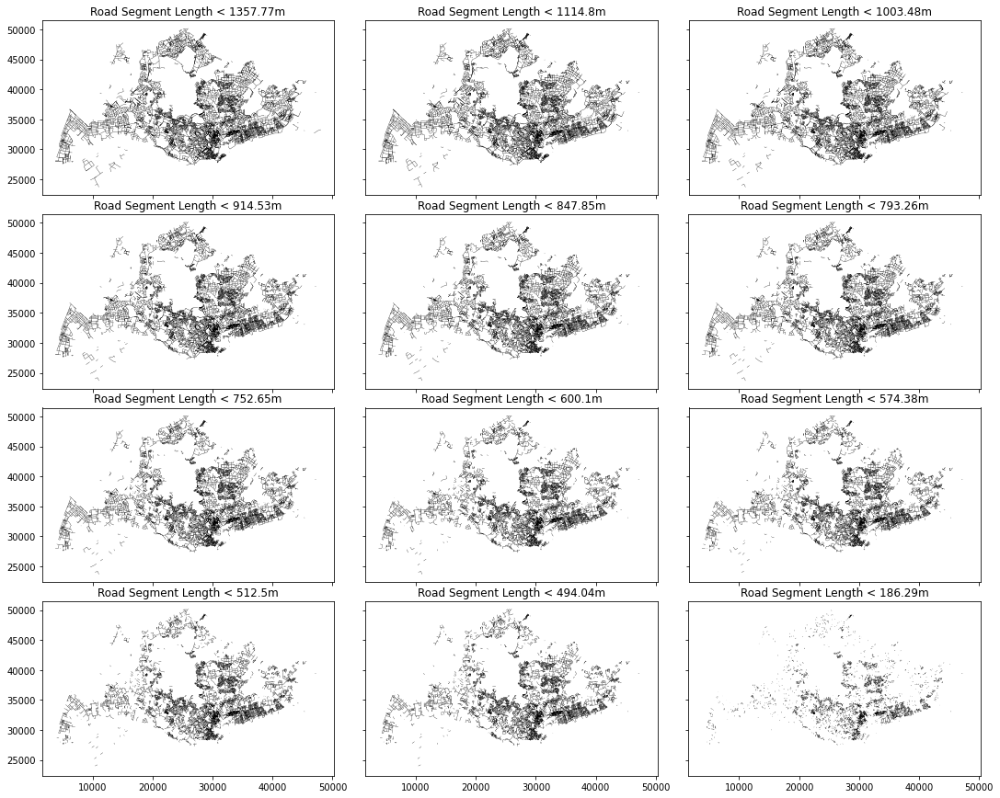

In [9]:
fig, axs = plt.subplots(4, 3, figsize=(15,12), sharex=True, sharey=True)
fig.subplots_adjust(wspace=0, hspace=0)
plt.tight_layout()
n = 0
for perc_lim in selected_perc_lim:
    # subset the dataframe
    segmented_df = road_network[road_network['Shape_Leng'] < perc_lim]
    # initialise the subplot
    n_ax = axs[int(n/3),n%3]
    # plot the dataframe subset
    segmented_df.plot(ax=n_ax, linewidth=0.3, color='k')
    # formatting
    n_ax.title.set_text('Road Segment Length < {}m'.format(round(perc_lim, 2)))
    # n_ax.set_facecolor('black')
    n += 1

We can visually observe that as the percolation threshold decreases, the entire network breaks down from a connected whole to localised clusters. And of course, considerable spatial heterogeneity is observed. Naturally network density varies spatially. Some clusters also persist longer while others quickly breaks down.

## Plot Component Size/Number Change with Percolation threshold

What we have presented above is very crude visual observations of how a network breaks down when we lower the cost threshold of travelling. We now present, how the number of connected components in the network, and the size of the largest component, vary with the range of percolation threshold. For this, we will need libraries e.g. networkx that can efficiently deal with graphs/networks.

In [ ]:
# the edgelist is generated using pairs of intersections or start/end points, the weight representing physical length of the road segment in the shapefile
simplified_network = nx.read_weighted_edgelist(r"data/roadsegment.edgelist")

In [ ]:
road_network['points'] = road_network.apply(lambda x: [y for y in x['geometry'].coords], axis=1)

In [ ]:
# round length list to integer value and remove duplicates
clean_length_list = sorted(list(set([round(n, 0) for n in length_list])), reverse=True)
len(clean_length_list)

In [ ]:
import warnings
warnings.filterwarnings('ignore')

network_property_list = []

for perc_lim in clean_length_list:
    network_property = {}
    # subset the dataframe
    filtered_edges = [(a,b) for a, b, attrs in simplified_network.edges(data=True) if attrs["weight"] < perc_lim]
    # convert to network
    segmented_network = nx.Graph(filtered_edges)
    # get no. of cc
    number_cc = nx.number_connected_components(segmented_network)
    # get size of largest cc
    try:
        size_cc = [len(c) for c in sorted(nx.connected_components(segmented_network), key=len, reverse=True)][0]
    except:
        size_cc = 0
    try:
        size_second_cc = [len(c) for c in sorted(nx.connected_components(segmented_network), key=len, reverse=True)][1]
    except:
        size_second_cc = 0  # in case the network only has one component
    # road_network = label_component(road_network, perc_lim, nx.connected_components(segmented_network))
    network_property['count_cc'] = number_cc
    network_property['perc_lim'] = perc_lim
    network_property['largest_cc'] = size_cc
    network_property['second_cc'] = size_second_cc
    network_property_list.append(network_property)


In [ ]:
len(network_property_list)

In [ ]:
network_df = pd.DataFrame(network_property_list)

In [ ]:
network_df.head()

In [ ]:
network_df = network_df.sort_values(by='perc_lim', axis=0)
network_df.head()

In [ ]:
fig,ax = plt.subplots(figsize=(15,10))


# plot size of the largest and second largest component by threshold value
ax.plot('perc_lim', 'largest_cc', data=network_df,color="red",marker="o", label='Largest Component Size', alpha=0.5, markersize=2)
ax.plot('perc_lim', 'second_cc', data=network_df, color="coral",marker="o", label='Second Largest Component Size',zorder=1, alpha=0.5, markersize=2)
ax.set_ylabel("Size of Component",color="firebrick",fontsize=14)
plt.legend()
# make a plot
ax2=ax.twinx()
ax2.plot('perc_lim', 'count_cc', data=network_df, color="k", marker="x", label='No. of Components', alpha=0.3, linewidth=1)
# set x-axis label
ax2.set_xlabel("Percolation Threshold (m)",fontsize=14)
# set y-axis label
ax2.set_ylabel("Number of Components",color="k",fontsize=14)
# twin object for two different y-axis on the same plot

plt.xticks(np.arange(0, np.max(network_df['perc_lim'])+1, 500))
# plt.gca().invert_xaxis()

plt.show()


One striking observation is how the size of the largest component quickly drops at a certain "critical" percolation threshold (around 1400m). Subsequently multiple simililar "critical" values are observed.
The size of the second largest cluster is considerably smaller than the largest component. Only at p=800m then did the second largest cluster becomes approximately larger than half of the largest cluster. 


In [ ]:
# finding the threshold value at which the number of components peaks
max_no_cc = network_df[network_df['count_cc']==np.max(network_df['count_cc'])]
max_no_cc

In [ ]:
network_df.sort_values(by='perc_lim', ascending=False).head()

Something to note is that, the no. of components started out to be >300, which should not be the case (expected to be 1 since all roads should be connected). This is due to the topological errors in the road network dataset, and ideally should be addressed before this exercise.

To illustrate how the network looks like at each "critical" value, we plotted the same maps, this time with the know threshold values. This time we also highlight the critical links that have been removed between two threshold values.

In [ ]:
# selected critical road segment lengths based on above understanding
selected_perc_lim = [6500, 1800, 1700, 1400, 1300, 900, 800, 700, 600, 500, 400, 300]

fig, axs = plt.subplots(4, 3, figsize=(20,15), sharex=True, sharey=True)
fig.subplots_adjust(wspace=0, hspace=0)
plt.tight_layout()
n = 0

for perc_lim in selected_perc_lim:
 
    # subset the dataframe
    segmented_df = road_network[road_network['Shape_Leng'] < perc_lim]
    # initialise the subplot
    n_ax = axs[int(n/3),n%3]
    # plot the dataframe subset
    segmented_df.plot(ax=n_ax, linewidth=0.4, color='k', alpha=0.8)
    # formatting
    title_text = 'Road Segment Length < {}m'.format(round(perc_lim, 2))
    # n_ax.title.set_text('Road Segment Length < {}m'.format(round(perc_lim, 2)))

    # highlight the critical links that have been removed between the last and this threshold
    if perc_lim != 6500:
        removed_df = road_network.loc[(road_network['Shape_Leng'] > perc_lim) & (road_network['Shape_Leng'] <= last_perc_lim)]
        removed_df.plot(ax=n_ax, linewidth=0.5, color='red')
    # n_ax.set_facecolor('black')
    n_ax.text(.03, .95, title_text,
        va='top', ha='left',
        transform=n_ax.transAxes)

    last_perc_lim = perc_lim
    n += 1
plt.savefig(r"data\Perc.jpg")

To take the visualisation further, it would be good to show each component by a distinct color.